# Aligning single-cell resolution breast cancer spatial transcriptomics data to corresponding H&E staining image from Xenium

In [1]:
# import dependencies
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import torch

# make plots bigger
plt.rcParams["figure.figsize"] = (12,10)

In [2]:
# OPTION A: import STalign after pip or pipenv install
from STalign import STalign

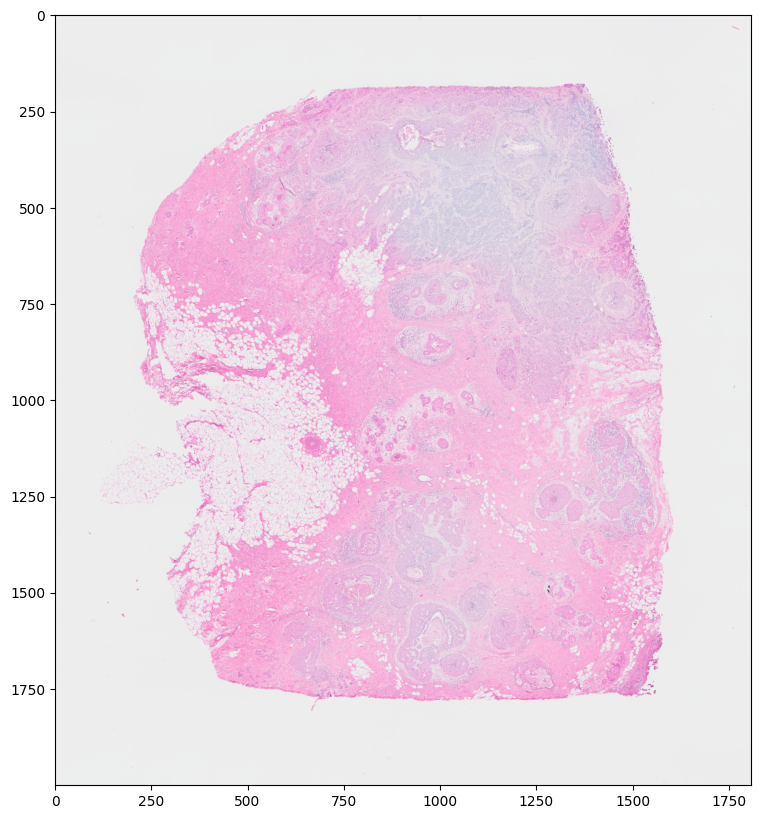

In [3]:
# Target is H&E staining image
image_file = '/home/caleb/Desktop/improvedgenepred/data/breastcancer_visium/spatial/tissue_hires_image.png'
V = plt.imread(image_file)

# plot
fig,ax = plt.subplots()
ax.imshow(V)

Note that this is an RGB image that `matplotlib.pyplot` had read in as an NxMx3 matrix with values ranging from 0 to 1.

In [4]:
print(V.shape)
print(V.min())
print(V.max())

(2000, 1809, 3)
0.02745098
0.99215686


We will use `STalign` to normalize the image in case there are any outlier intensities. 

0.0
1.0


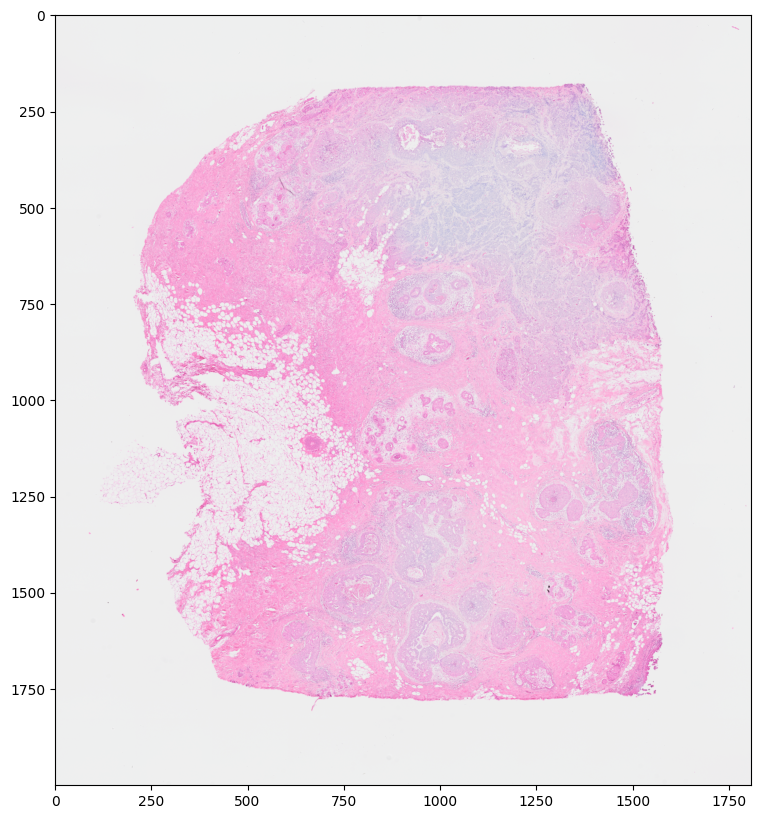

In [5]:
Inorm = STalign.normalize(V)

print(Inorm.min())
print(Inorm.max())

fig,ax = plt.subplots()
ax.imshow(Inorm)

We will transpose `Inorm` to be a 3xNxM matrix for downstream analyses. We will also create some variances `YI` and `XI` to keep track of the image size.

In [6]:
I = Inorm.transpose(2,0,1)
print(I.shape)

YI = np.array(range(I.shape[1]))*1. # needs to be longs not doubles for STalign.transform later so multiply by 1.
XI = np.array(range(I.shape[2]))*1. # needs to be longs not doubles for STalign.transform later so multiply by 1.
extentI = STalign.extent_from_x((YI,XI))

(3, 2000, 1809)


We can also now read in the next image

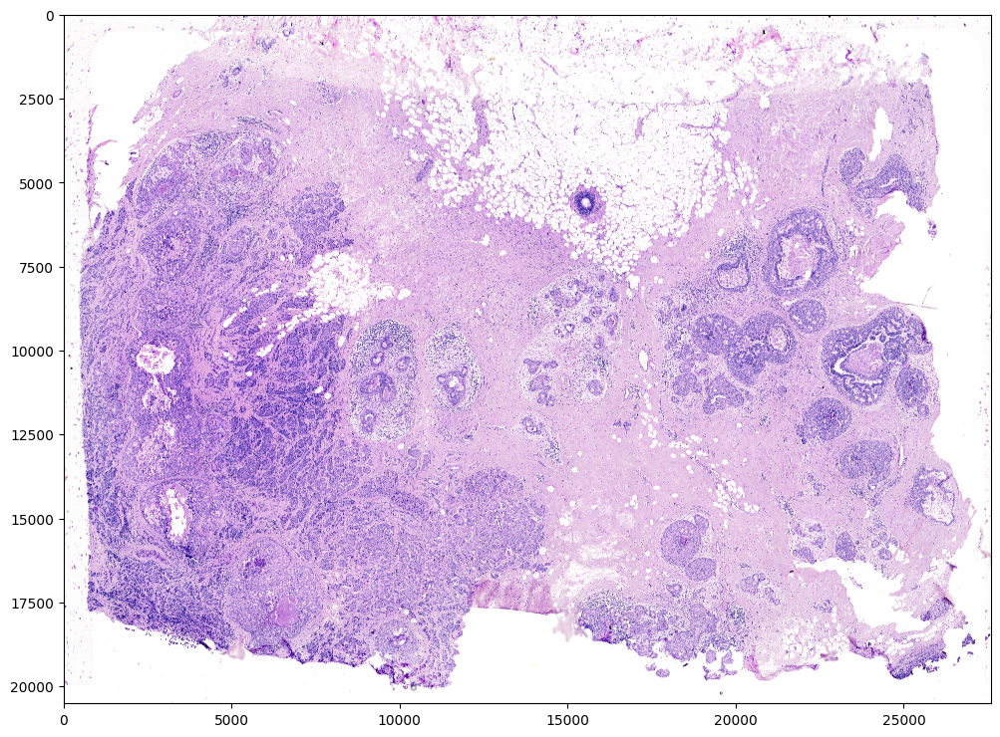

In [7]:
from PIL import Image
Image.MAX_IMAGE_PIXELS = None

#  Single cell data to be aligned
image_file2 = "/home/caleb/Desktop/improvedgenepred/data/breastcancer_xenium_sample1_rep1/Xenium_FFPE_Human_Breast_Cancer_Rep1_he_image.tif"
# image_file2 = "/home/caleb/Desktop/projects_caleb/histology_to_gene_prediction/data/breastcancer_xenium_sample1_rep1/Xenium_FFPE_Human_Breast_Cancer_Rep1_he_image.png"
V2 = np.array(Image.open(image_file2))

# plot
fig,ax = plt.subplots()
ax.imshow(V2)

For alignment with `STalign`, we only need the cell centroid information. So we can pull out this information. We can further visualize the cell centroids to get a sense of the variation in cell density that we will be relying on for our alignment by plotting using `matplotlib.pyplot` as `plt`. 

In [8]:
Inorm2 = STalign.normalize(V2)

print(Inorm2.min())
print(Inorm2.max())

# fig,ax = plt.subplots()
# ax.imshow(Inorm2)

0.0
1.0


In [9]:
I2 = Inorm2.transpose(2,0,1)
print(I2.shape)

YI2 = np.array(range(I2.shape[1]))*1. # needs to be longs not doubles for STalign.transform later so multiply by 1.
XI2 = np.array(range(I2.shape[2]))*1. # needs to be longs not doubles for STalign.transform later so multiply by 1.
extentI2 = STalign.extent_from_x((YI2,XI2))

(3, 20511, 27587)


Note that plotting the cell centroid positions on the corresponding H&E image shows that alignment is still needed.

(-0.5, 27586.5, 20510.5, -0.5)

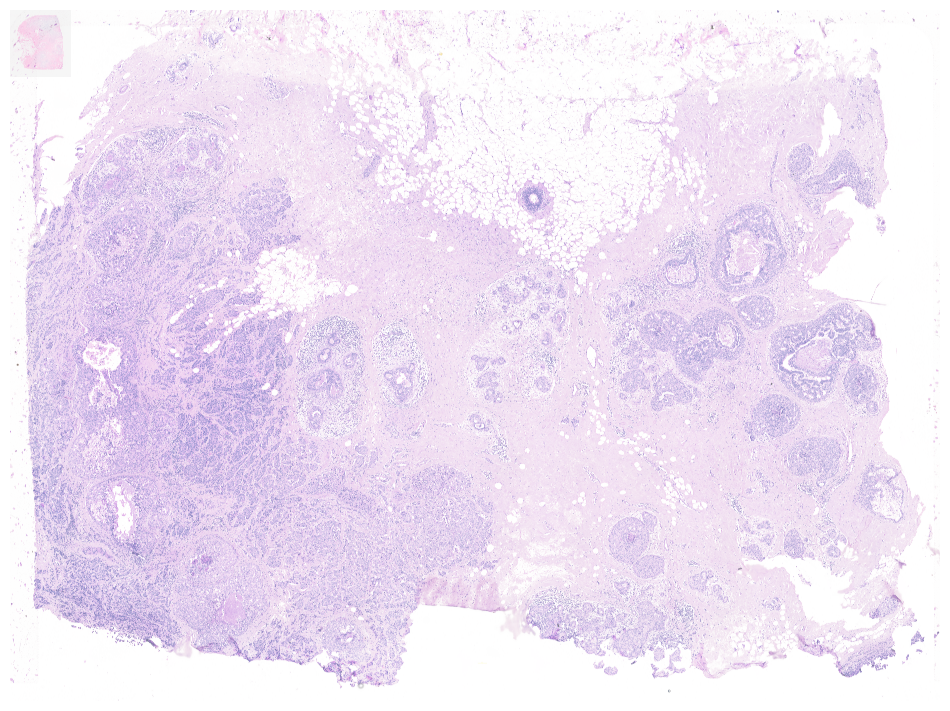

In [10]:
# plot
fig,ax = plt.subplots()
ax.imshow((I).transpose(1,2,0),extent=extentI)
ax.imshow((I2).transpose(1,2,0),extent=extentI2,alpha=0.5)
ax.axis('off')

To begin our alignment, we will use STalign to rasterize the single cell centroid positions into an image. Assuming the single-cell centroid coordinates are in microns, we will perform this rasterization at a 30 micron resolution. We can visualize the resulting rasterized image.

Note that points are plotting with the origin at bottom left while images are typically plotted with origin at top left so we've used `invert_yaxis()` to invert the yaxis for visualization consistency.

`STalign` relies on an interative gradient descent to align these two images. This can be somewhat slow. We manually created 3 points that visually mark similar landmarks across the two datasets that we will use to initialize a simple affine alignment from the landmark points. 

We can double check that our landmark points look sensible by plotting them along with the rasterized image we created.

Run this code: 

In [12]:
import os


# Create a new directory
os.makedirs('data/breastcancer_visium_xenium_heimage', exist_ok=True)

# Save the variables to files
np.savez('data/breastcancer_visium_xenium_heimage/xenium_image', x=XI, y=YI, I=I)
np.savez('data/breastcancer_visium_xenium_heimage/visium_image', x=XI2, y=YI2, I=I2)

python point_annotator.py data/breastcancer_visium_xenium_heimage/xenium_image.npz data/breastcancer_visium_xenium_heimage/visium_image.npz

{'1': [(996.5896774193548, 1560.0954838709679)], '3': [(667.0793548387096, 1115.0425806451615)], '4': [(885.3264516129032, 772.6941935483874)], '5': [(1150.646451612903, 926.7509677419357)], '6': [(923.8406451612902, 344.7587096774196)], '7': [(1266.1890322580643, 1290.4961290322583)]}
{'1': [(23018.33010752689, 10581.297849462368)], '3': [(15578.73913978495, 5686.830107526886)], '4': [(10096.935268817208, 9341.366021505379)], '5': [(12707.318064516134, 13452.718924731184)], '6': [(3244.6804301075317, 10385.519139784948)], '7': [(18972.236774193552, 15084.20817204301)]}


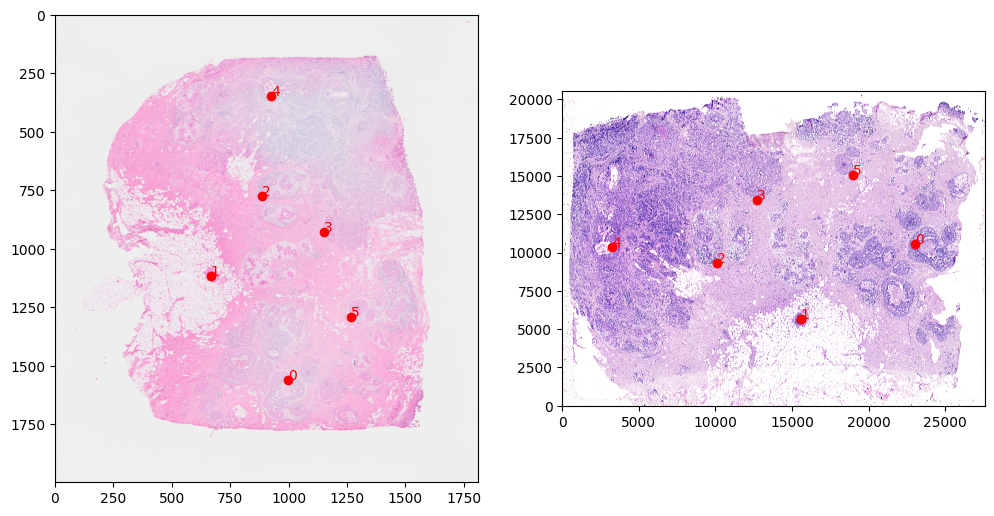

In [11]:
# read from file
pointsIlist = np.load('data/breastcancer_visium_xenium_heimage/xenium_image_points.npy', allow_pickle=True).tolist()
print(pointsIlist)
pointsJlist = np.load('data/breastcancer_visium_xenium_heimage/visium_image_points.npy', allow_pickle=True).tolist()
print(pointsJlist)

# convert to array
pointsI = []
pointsJ = []

for i in pointsIlist.keys():
    for j in range(len(pointsIlist[i])):
        pointsI.append([pointsIlist[i][j][1], pointsIlist[i][j][0]])
for i in pointsJlist.keys():
    for j in range(len(pointsJlist[i])):
        pointsJ.append([pointsJlist[i][j][1], pointsJlist[i][j][0]])

pointsI = np.array(pointsI)
pointsJ = np.array(pointsJ)

# plot
extentJ = STalign.extent_from_x((YI2,XI2))

fig,ax = plt.subplots(1,2)
ax[0].imshow((I.transpose(1,2,0).squeeze()), extent=extentI) 
ax[1].imshow((I2.transpose(1,2,0).squeeze()), extent=extentJ) 

ax[0].scatter(pointsI[:,1],pointsI[:,0], c='red')
ax[1].scatter(pointsJ[:,1],pointsJ[:,0], c='red')
for i in range(pointsI.shape[0]):
    ax[0].text(pointsI[i,1],pointsI[i,0],f'{i}', c='red')
    ax[1].text(pointsJ[i,1],pointsJ[i,0],f'{i}', c='red')

# invert only rasterized image
ax[1].invert_yaxis()

In [12]:
# compute initial affine transformation from points
L,T = STalign.L_T_from_points(pointsI,pointsJ)
A = STalign.to_A(torch.tensor(L),torch.tensor(T))


In [14]:
# compute initial affine transformation from points
AI = STalign.transform_image_source_with_A(A, [YI,XI], I.astype(float), [YI2,XI2])

#switch tensor from cuda to cpu for plotting with numpy
if AI.is_cuda:
    AI = AI.cpu()

# fig,ax = plt.subplots(1,2)

# ax[0].imshow((AI.permute(1,2,0).squeeze()), extent=extentJ)
# ax[1].imshow((I2.transpose(1,2,0).squeeze()), extent=extentJ)

# ax[0].set_title('source with affine transformation', fontsize=15)
# ax[1].set_title('target', fontsize=15)

/home/caleb/anaconda3/envs/pipeline/lib/python3.9/site-packages/STalign/STalign.py:1660: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(A)
/home/caleb/anaconda3/envs/pipeline/lib/python3.9/site-packages/STalign/STalign.py:1673: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  XJ = torch.tensor(XJ)


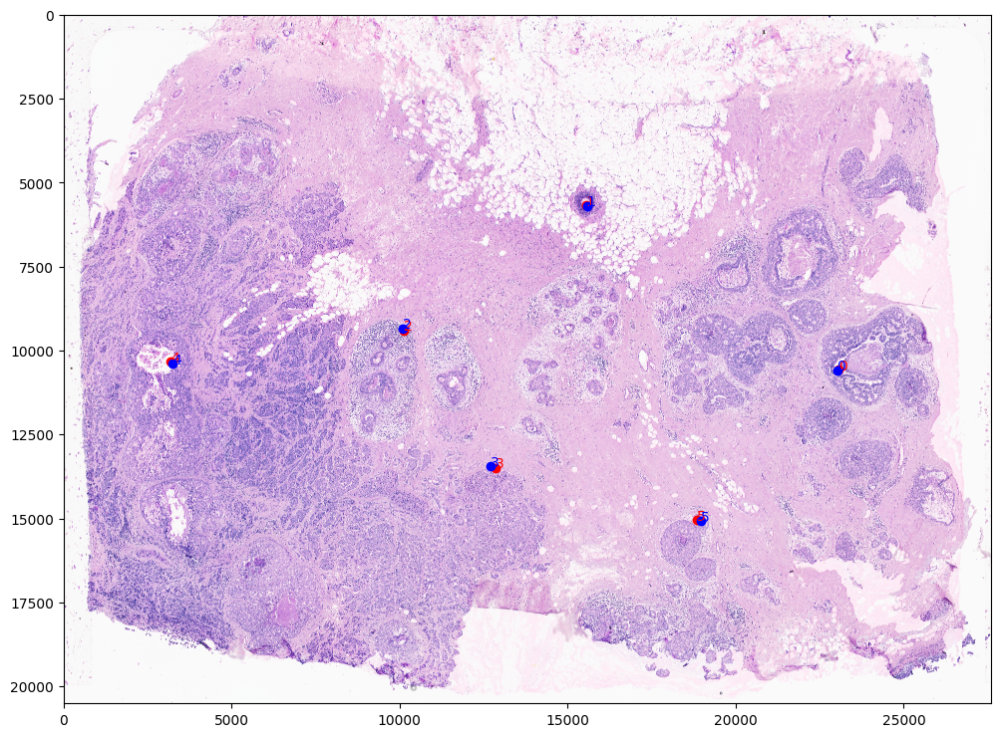

In [15]:
# plot results
fig,ax = plt.subplots()

ax.imshow((I2.transpose(1,2,0).squeeze()), extent=extentJ, alpha=1)
ax.imshow((AI.permute(1,2,0).squeeze()), extent=extentJ, alpha=.25)

#apply A to sources landmark points in row, column (y,x) orientation
ypointsI = pointsI[:,0]
xpointsI = pointsI[:,1]
affine = np.matmul(np.array(A.cpu()),np.array([ypointsI, xpointsI, np.ones(len(ypointsI))]))
xpointsIaffine = affine[1,:]
ypointsIaffine = affine[0,:]
pointsIaffine = np.column_stack((ypointsIaffine,xpointsIaffine))

ax.scatter(pointsIaffine[:,1],pointsIaffine[:,0], c='red')
ax.scatter(pointsJ[:,1],pointsJ[:,0], c='blue')
for i in range(pointsI.shape[0]):
    ax.text(pointsIaffine[i,1],pointsIaffine[i,0],f'{i}', c='red')
    ax.text(pointsJ[i,1],pointsJ[i,0],f'{i}', c='blue')


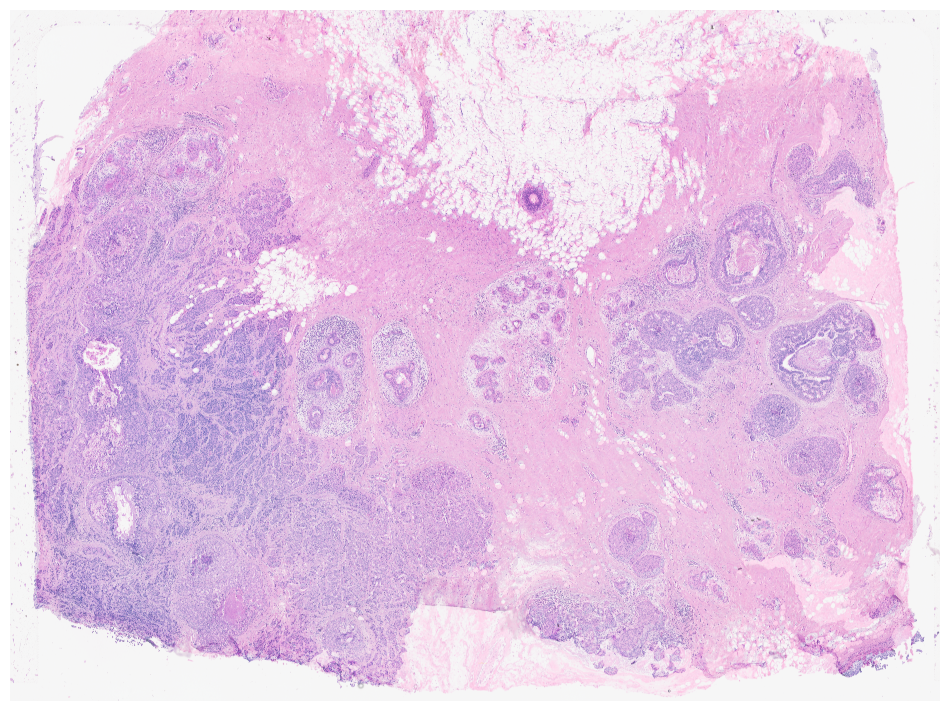

In [17]:
# plot results
fig,ax = plt.subplots()

ax.imshow((I2.transpose(1,2,0).squeeze()), extent=extentJ, alpha=1)
ax.imshow((AI.permute(1,2,0).squeeze()), extent=extentJ, alpha=.5)
# Remove all axis elements
ax.axis('off')
plt.savefig("/home/caleb/Desktop/improvedgenepred/05_figures/figure1/fig1b_visiumimage_xeniumimage_alignment.png", dpi = 1000)
#apply A to sources landmark points in row, column (y,x) orientation
# ypointsI = pointsI[:,0]
# xpointsI = pointsI[:,1]
# affine = np.matmul(np.array(A.cpu()),np.array([ypointsI, xpointsI, np.ones(len(ypointsI))]))
# xpointsIaffine = affine[1,:]
# ypointsIaffine = affine[0,:]
# pointsIaffine = np.column_stack((ypointsIaffine,xpointsIaffine))

# ax.scatter(pointsIaffine[:,1],pointsIaffine[:,0], c='red')
# ax.scatter(pointsJ[:,1],pointsJ[:,0], c='blue')
# for i in range(pointsI.shape[0]):
#     ax.text(pointsIaffine[i,1],pointsIaffine[i,0],f'{i}', c='red')
#     ax.text(pointsJ[i,1],pointsJ[i,0],f'{i}', c='blue')


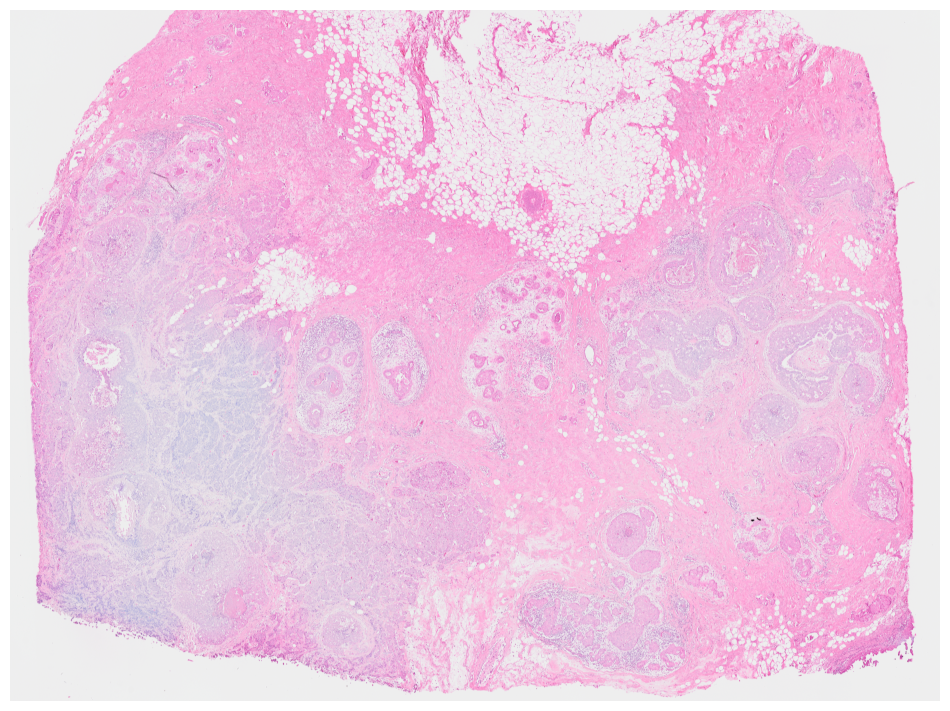

In [ ]:
# plot the visium transformed image
plt.imshow((AI.permute(1,2,0).squeeze()), extent=extentJ)
plt.axis('off')

In [ ]:
# save the viisum transformed image
np.save('/home/caleb/Desktop/improvedgenepred/data/breastcancer_visium/spatial/tissue_alignedtoxenium.npy', np.array(AI.permute(1,2,0).squeeze()))

In [29]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from PIL import Image


### Read in the Data ###


### Read in adata ###
# file path where outs data is located
file_path = "/home/caleb/Desktop/projects_caleb/histology_to_gene_prediction/data/breastcancer_visium/"
# should be the name of image data in adata
tissue_section = "CytAssist_FFPE_Human_Breast_Cancer"

# read data
adata_visium = sc.read_visium(file_path)
# make unique
adata_visium.var_names_make_unique()
# get mitochondrial gene expression info
adata_visium.var["mt"] = adata_visium.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata_visium, qc_vars=["mt"], inplace=True)

# make spatial position str to integer
# https://discourse.scverse.org/t/data-fomr-new-spatial-transcriptomics-from-10x/1107/6
adata_visium.obsm['spatial'] = adata_visium.obsm['spatial'].astype(int)

# normalize data
# sc.pp.normalize_total(adata, inplace=True) # NOTE: same scale, proportion
# scp.normalize.library_size_normalize(adata)
# sc.pp.normalize_total(adata, target_sum=1e6)
# sc.pp.log1p(adata_visium)
# sc.pp.highly_variable_genes(adata, flavor="seurat", n_top_genes=1000)

# scale data - CRUCIAL for doing when using the hires image to crop
adata_visium.obsm['spatial'] = np.floor(adata_visium.obsm["spatial"].astype(np.int64) * adata_visium.uns['spatial'][tissue_section]["scalefactors"]["tissue_hires_scalef"]).astype(int)
adata_visium.obsm['spatial'].shape

# plt.imshow(adata_visium.uns['spatial'][tissue_section]["images"]["hires"])


/home/caleb/anaconda3/envs/pipeline/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/caleb/anaconda3/envs/pipeline/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


(4992, 2)

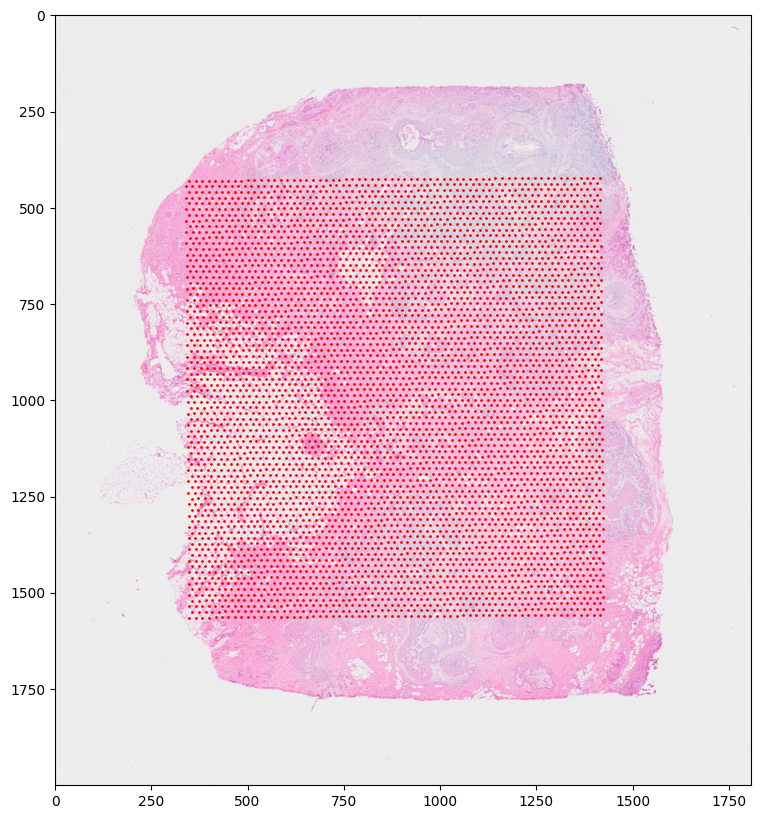

In [30]:
plt.imshow(adata_visium.uns['spatial'][tissue_section]["images"]["hires"])
plt.scatter(adata_visium.obsm['spatial'][:, 0], adata_visium.obsm['spatial'][:, 1], s=1, c='red')

# sc.pl.spatial(adata_visium, color=["LUM"], scale_factor = 1, size=adata_visium.uns['spatial'][tissue_section]['scalefactors']['tissue_hires_scalef'],frameon= False, title = "LUM")

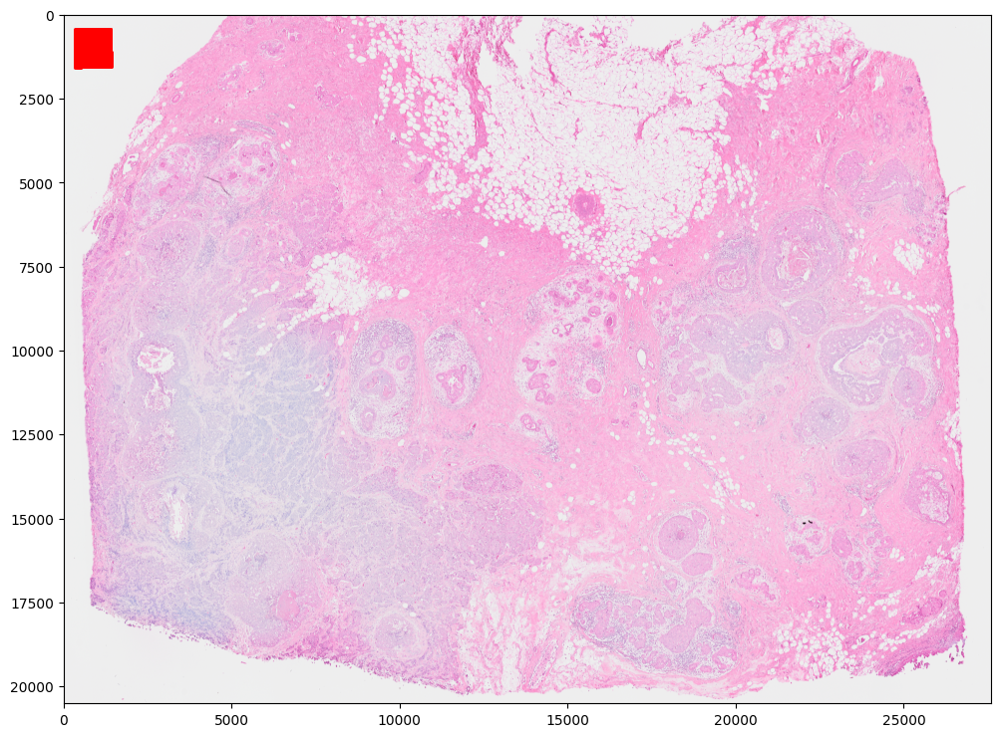

In [30]:
plt.imshow((AI.permute(1,2,0).squeeze()))
plt.scatter(adata_visium.obsm['spatial'][:, 0], adata_visium.obsm['spatial'][:, 1], s=1, c='red')


In [139]:
# #apply A to sources landmark points in row, column (y,x) orientation
# ypointsI = adata_visium.obsm['spatial'][:, 0]
# xpointsI = adata_visium.obsm['spatial'][:, 1]
# affine = np.matmul(np.array(A.cpu()),np.array([ypointsI, xpointsI, np.ones(len(ypointsI))]))
# xpointsIaffine = affine[1,:]
# ypointsIaffine = affine[0,:]
# pointsIaffine = np.column_stack((ypointsIaffine,xpointsIaffine))

# plt.imshow((AI.permute(1,2,0).squeeze()))
# plt.scatter(pointsIaffine[:, 0], pointsIaffine[:, 1], s=1, c='red')


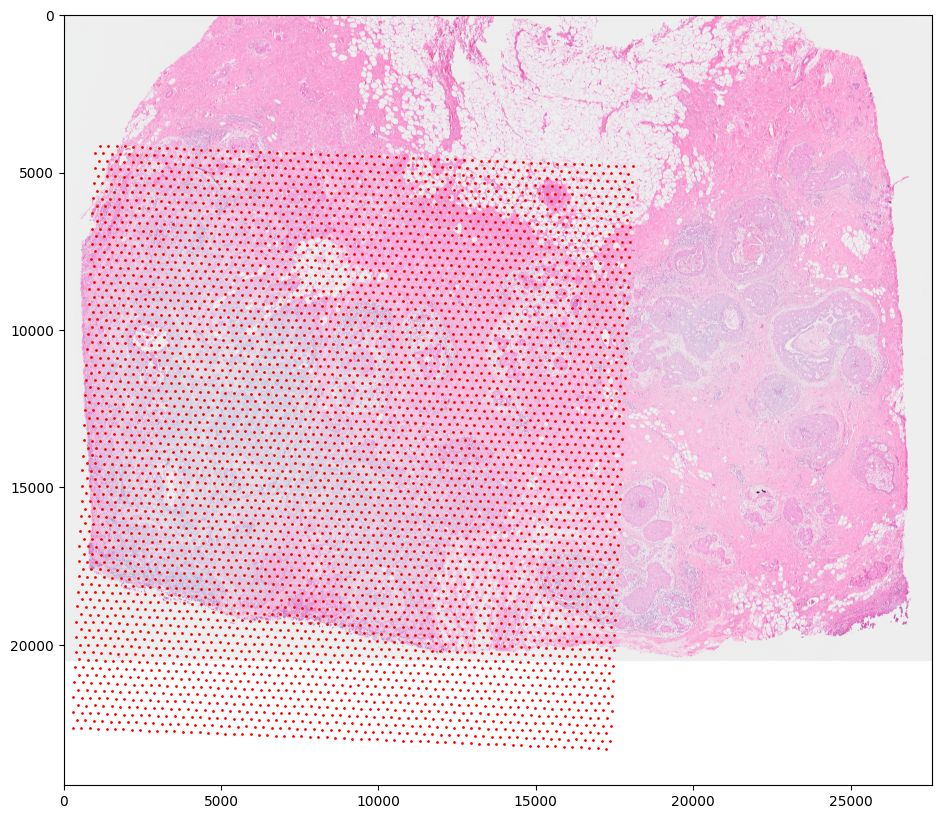

In [31]:
# swap the columns to put in row column order
points_visium = adata_visium.obsm['spatial'][:, [1, 0]]
points_visium
pointsIt = (A[:2,:2]@points_visium.T + A[:2,-1][...,None]).T
# rotate the points 90 degrees


plt.imshow((AI.permute(1,2,0).squeeze()))
plt.scatter(pointsIt[:, 0], pointsIt[:, 1], s=1, c='red')


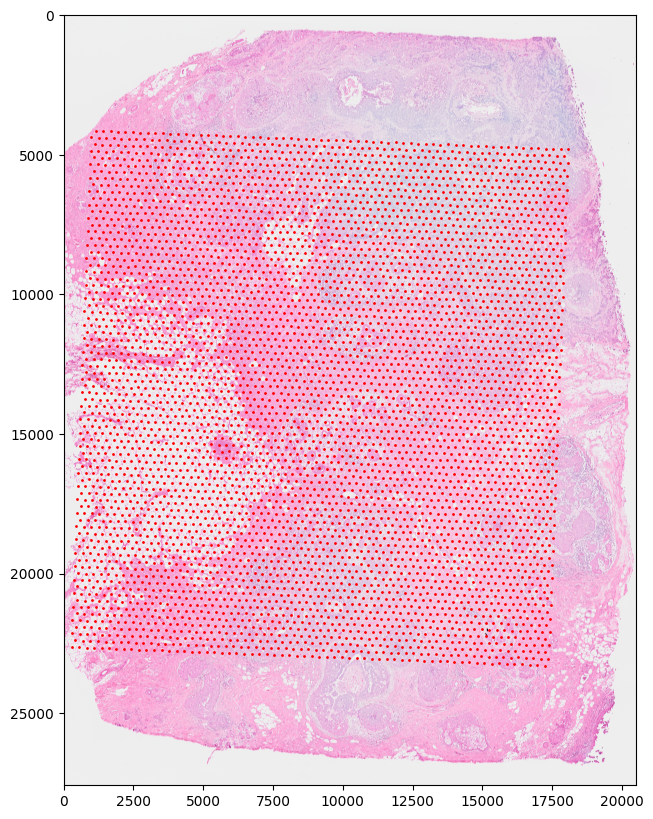

In [32]:
plt.imshow(np.flipud(np.rot90(np.array((AI.permute(1,2,0).squeeze())))))
plt.scatter(pointsIt[:, 0], pointsIt[:, 1], s=1, c='red')


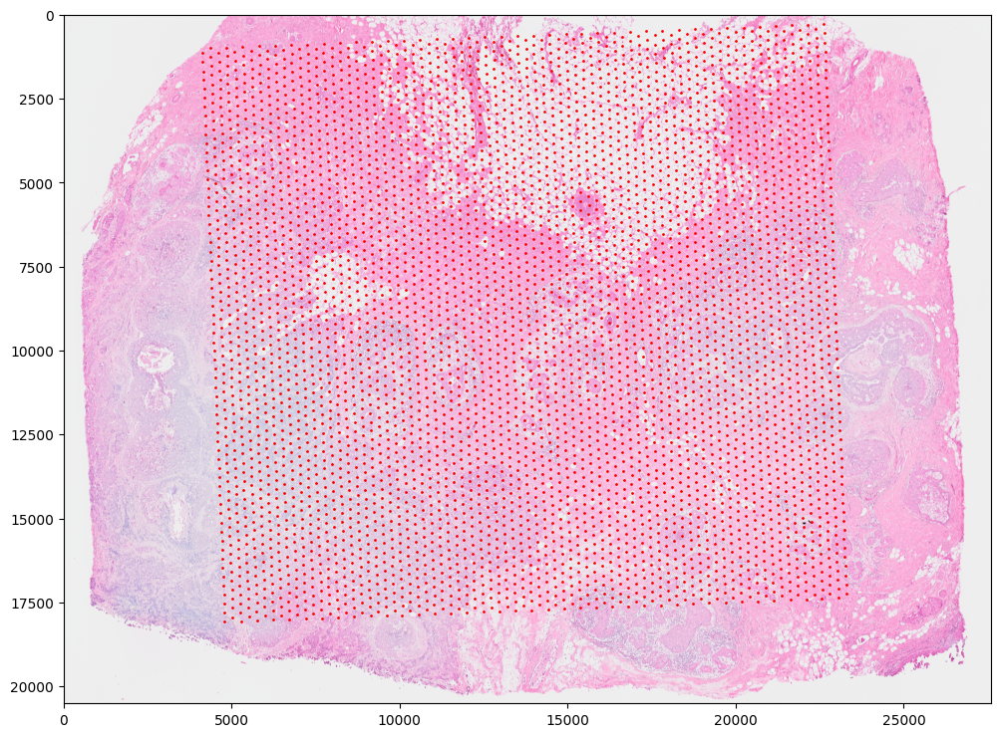

In [32]:
def transform_points(points, image_height, image_width):
    transformed_points = []
    for row, col in points:
        # Step 1: Rotate 90 degrees counterclockwise
        new_row = col
        new_col = (image_height - 1 - row)*-1
        
        # Step 2: Flip upside down (flipud equivalent)
        # new_row = image_width - 1 - new_row
        
        transformed_points.append([new_row, new_col])
    
    return np.array(transformed_points)

image_height, image_width = AI.shape[0], AI.shape[1]  # Get image dimensions

aligned_points = transform_points(np.array(pointsIt), image_height, image_width)

aligned_points
plt.imshow((AI.permute(1,2,0).squeeze()))
plt.scatter(aligned_points[:, 0], aligned_points[:, 1], s=1, c='red')

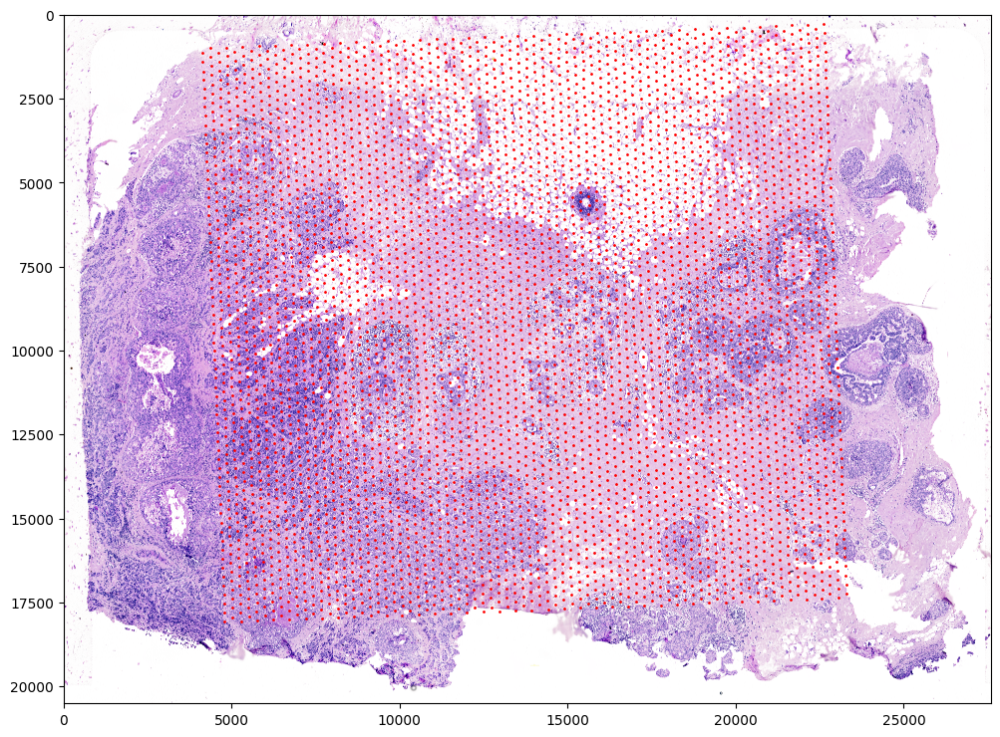

In [33]:
plt.imshow(V2)
plt.scatter(aligned_points[:, 0], aligned_points[:, 1], s=1, c='red')

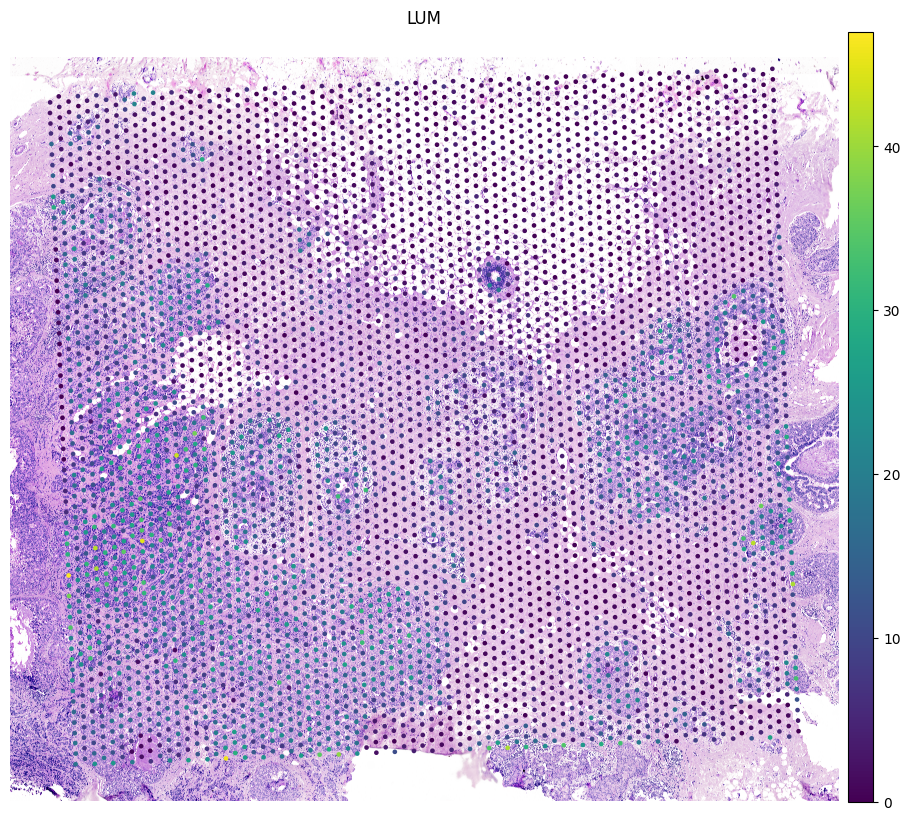

In [72]:
adata_visium_transformed = adata_visium.copy()

adata_visium_transformed.obsm['spatial'] = aligned_points
# adata_visium_transformed.uns['spatial'][tissue_section]["images"]["hires"] = np.flipud(np.rot90(np.array((AI.permute(1,2,0).squeeze()))))
adata_visium_transformed.uns['spatial'][tissue_section]["images"]["hires"] = V2

# sc.pl.spatial(adata_visium, color=["TOMM7"], scale_factor = 1, size=adata_visium.uns['spatial'][tissue_section]['scalefactors']['tissue_hires_scalef'],frameon= False, title = "LUM")
sc.pl.spatial(adata_visium_transformed, color=["TOMM7"], scale_factor = 1, size=adata_visium_transformed.uns['spatial'][tissue_section]['scalefactors']['tissue_hires_scalef']*10,frameon= False, title = "LUM")

In [34]:
# save the aligned data
np.save('/home/caleb/Desktop/improvedgenepred/data/breastcancer_xenium_sample1_rep1/aligned_visium_points_to_xenium_image.npy', aligned_points)
np.save('/home/caleb/Desktop/improvedgenepred/data/breastcancer_visium/aligned_visium_points_to_xenium_image.npy', aligned_points)

In [ ]:
# find minimum distance between points

from scipy.spatial import distance

aligned_points
# Calculate the pairwise distances between points
distances = distance.cdist(aligned_points, aligned_points, 'euclidean')

# Set the diagonal to infinity to exclude zero distances
np.fill_diagonal(distances, np.inf)

# Find the minimum distance
min_distance = np.min(distances)
min_distance

254.35377223268213

In [ ]:
# Find the minimum distance between points and look at next highest
np.sort(distances)

array([[  254.35377223,   270.250883  ,   275.88530284, ...,
        24565.49286117, 24661.97272956,            inf],
       [  261.35227487,   269.61384453,   270.250883  , ...,
        22914.82841538, 23005.69156065,            inf],
       [  261.35227487,   269.61384453,   270.250883  , ...,
        14602.18631903, 14786.12127234,            inf],
       ...,
       [  261.35227487,   261.51500717,   270.250883  , ...,
        18182.32452518, 18325.84168989,            inf],
       [  269.61384453,   270.250883  ,   270.250883  , ...,
        15787.74032198, 15857.23564051,            inf],
       [  269.61384453,   270.250883  ,   283.39379962, ...,
        19500.73764679, 19506.72170343,            inf]])

: 